# Rough EDA – Spotify Tracks Dataset
This notebook performs a **systematic exploratory data analysis (EDA)** on the Spotify tracks dataset.

**Flow of analysis:**
1. Data overview & structure
2. Target / key variable distributions
3. Genre-based analysis
4. Audio feature distributions
5. Relationships between features

All visualizations use a **Spotify theme** and **green color palette** for consistency.

In [1]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


BG = "#e1ece3"
PRIMARY = "#62d089"
EMPHASIS = "#457e59"
GRID = "#a8b2a8"

plt.rcParams.update({
    "figure.facecolor": BG,
    "axes.facecolor": BG,
    "axes.edgecolor": BG,
    "axes.labelcolor": "#2b2b2b",
    "xtick.color": "#2b2b2b",
    "ytick.color": "#2b2b2b",
    "grid.color": GRID,
    "grid.alpha": 0.4,
    "axes.grid": True,
    "font.size": 11
})


In [2]:
df = pd.read_csv('../data/spotify_dedup.csv')


## 1. Distribution of Track Popularity

Popularity is bounded between 0 and 100 and is expected to be unevenly distributed.
This section visualizes the distribution using multiple complementary views.


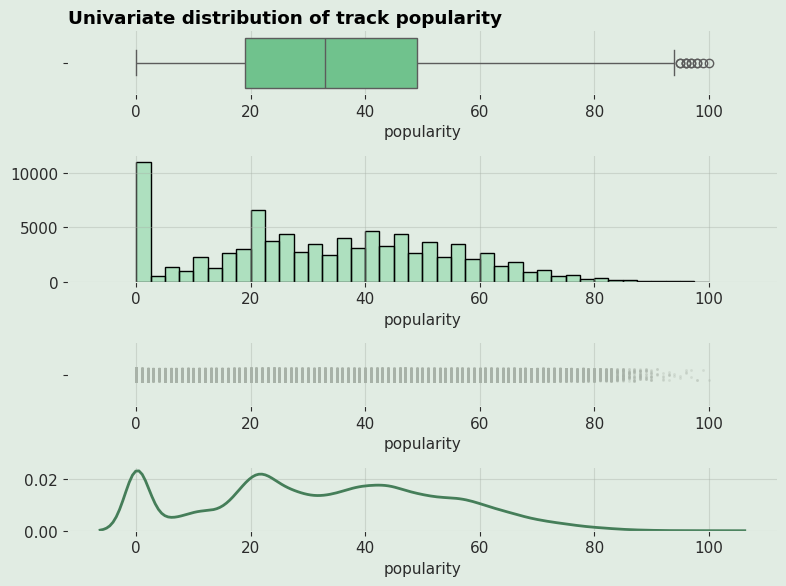

In [3]:

def plot_univariate(series, title):
    fig = plt.figure(figsize=(8, 6))
    gs = fig.add_gridspec(4, 1, height_ratios=[1, 2, 1, 1])

    ax_box = fig.add_subplot(gs[0])
    ax_hist = fig.add_subplot(gs[1], sharex=ax_box)
    ax_strip = fig.add_subplot(gs[2], sharex=ax_box)
    ax_kde = fig.add_subplot(gs[3], sharex=ax_box)

    sns.boxplot(x=series, ax=ax_box, color=PRIMARY)
    sns.histplot(series, ax=ax_hist, bins=40, color=PRIMARY, alpha=0.4)
    sns.stripplot(x=series, ax=ax_strip, color=GRID, alpha=0.3, size=2)
    sns.kdeplot(x=series, ax=ax_kde, color=EMPHASIS, linewidth=2)

    ax_box.set_title(title, loc="left", weight="bold")
    for ax in [ax_box, ax_hist, ax_strip, ax_kde]:
        ax.set_ylabel("")
        sns.despine(ax=ax)

    plt.tight_layout()
    plt.show()

plot_univariate(df['popularity'], 'Univariate distribution of track popularity')


## 2. Audio Features vs Popularity

Scatter plots with LOWESS smoothing are used to explore relationships between individual
audio features and popularity without imposing strict linear assumptions.


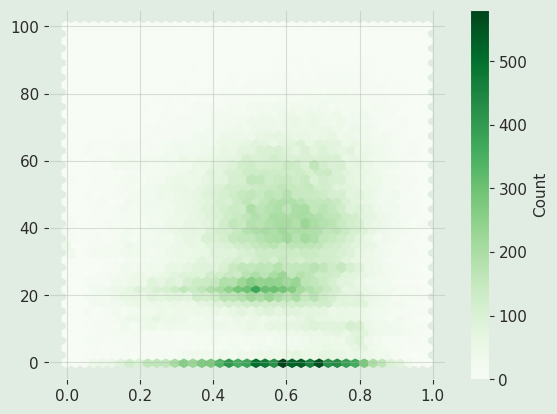

In [4]:
plt.hexbin(
    df['danceability'],
    df['popularity'],
    gridsize=40,
    cmap='Greens'
)
plt.colorbar(label='Count')


<Axes: xlabel='danceability'>

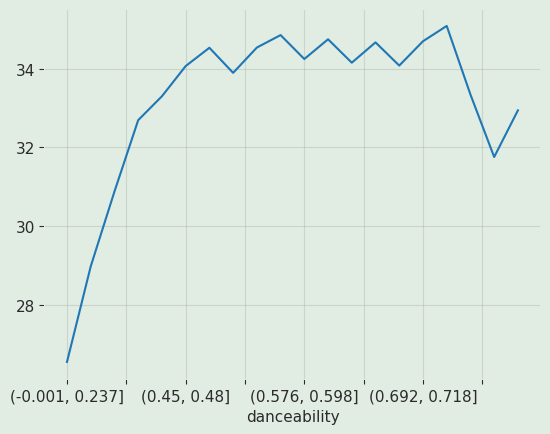

In [25]:
pd.qcut(df['danceability'], 20).to_frame() \
    .join(df['popularity']) \
    .groupby('danceability', observed=True)['popularity'] \
    .mean() \
    .plot()


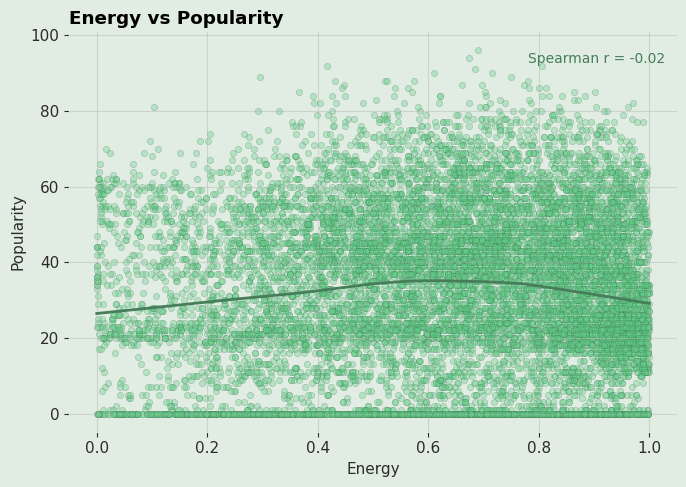

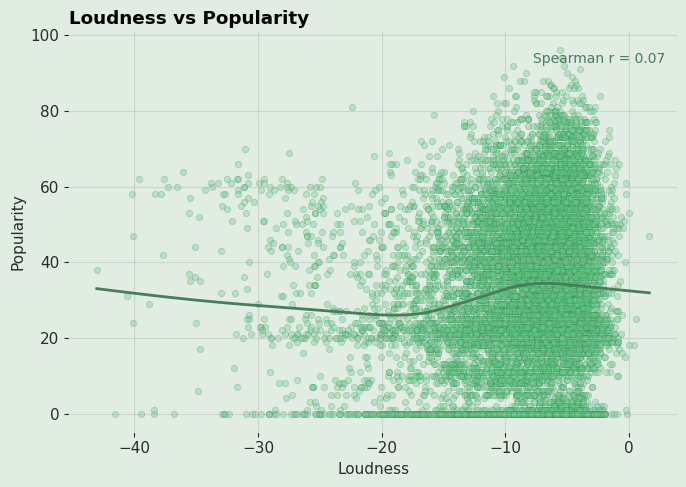

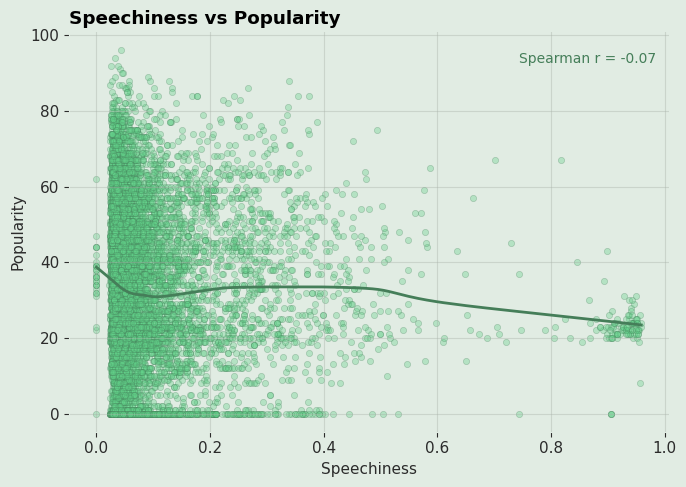

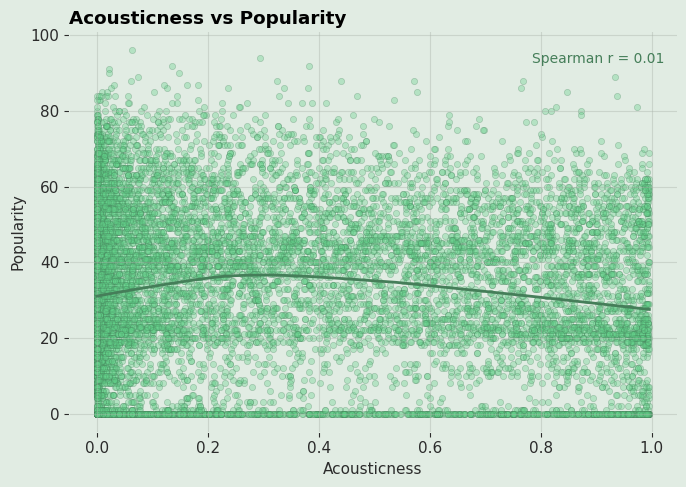

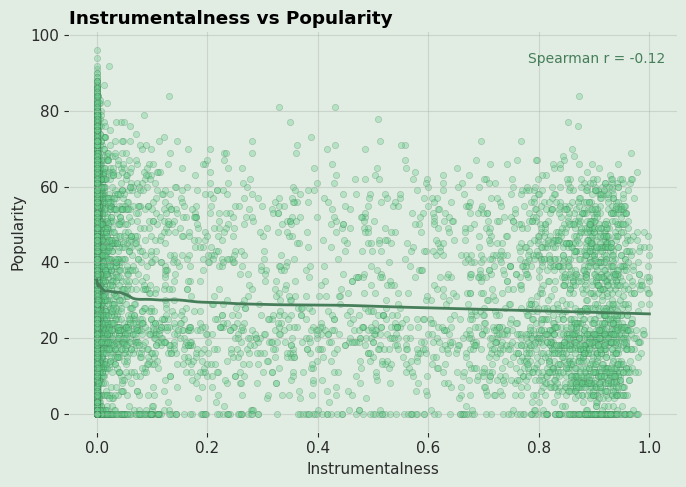

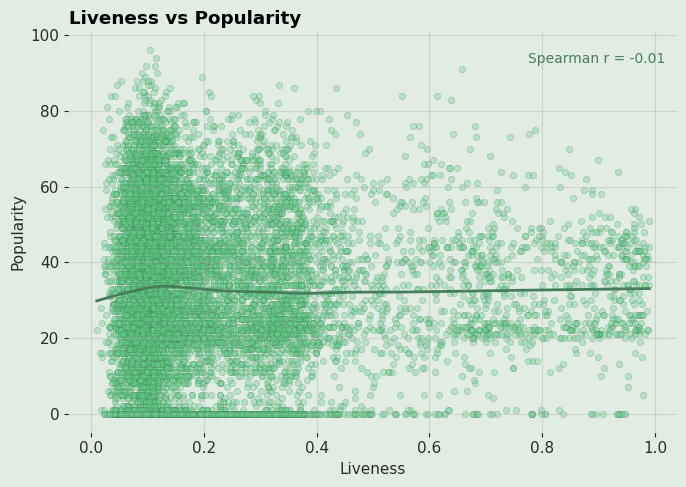

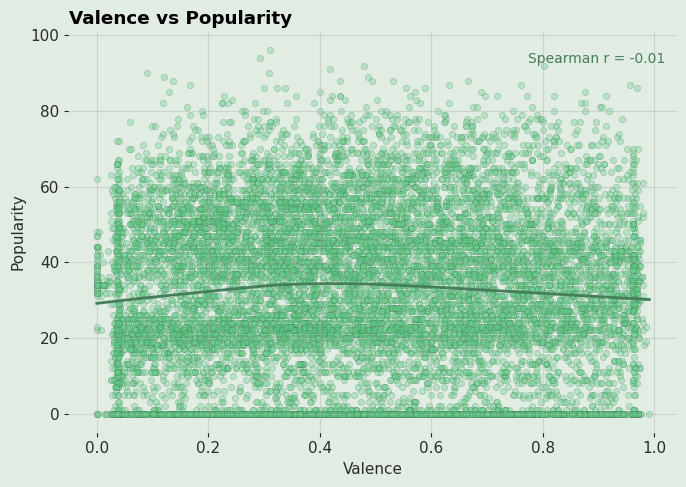

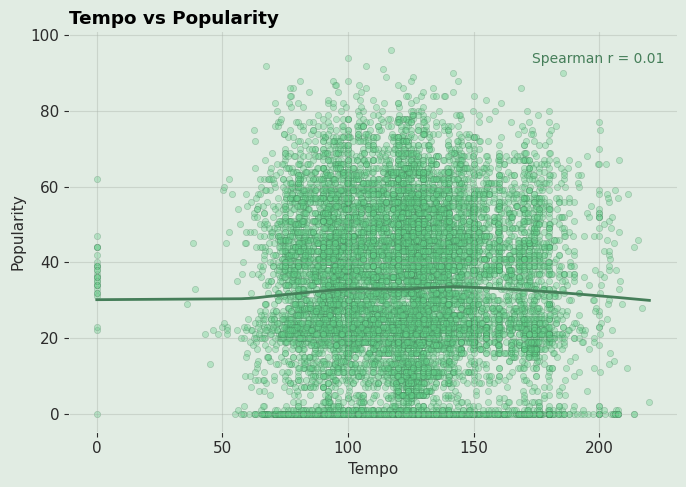

In [11]:
from scipy.stats import spearmanr
def scatter_vs_popularity(df, feature, sample_size=12000, random_state=42):
    """
    Scalable scatter plot for large datasets.
    Uses subsampling for visualization while keeping
    statistics computed on full data.
    """

    # Drop missing values
    clean_df = df[[feature, 'popularity']].dropna()

    # Subsample for plotting (important for performance)
    if len(clean_df) > sample_size:
        plot_df = clean_df.sample(sample_size, random_state=random_state)
    else:
        plot_df = clean_df

    # Spearman correlation on FULL data
    corr, _ = spearmanr(clean_df[feature], clean_df['popularity'])

    plt.figure(figsize=(7, 5))

    # Scatter plot
    plt.scatter(
        plot_df[feature],
        plot_df['popularity'],
        s=20,
        alpha=0.35,
        facecolor=PRIMARY,
        edgecolor=EMPHASIS,
        linewidth=0.5
    )

    # LOWESS on sampled data only
    sns.regplot(
        x=plot_df[feature],
        y=plot_df['popularity'],
        scatter=False,
        lowess=True,
        color=EMPHASIS,
        line_kws={"linewidth": 2}
    )

    plt.title(f"{feature.capitalize()} vs Popularity", loc="left", weight="bold")
    plt.xlabel(feature.capitalize())
    plt.ylabel("Popularity")

    plt.text(
        0.98, 0.95,
        f"Spearman r = {corr:.2f}",
        transform=plt.gca().transAxes,
        ha="right",
        va="top",
        fontsize=10,
        color=EMPHASIS
    )

    sns.despine()
    plt.tight_layout()
    plt.show()

numeric_features = [
    'energy',
    'loudness',
    'speechiness',
    'acousticness',
    'instrumentalness',
    'liveness',
    'valence',
    'tempo'
]

for col in numeric_features:
    scatter_vs_popularity(df, col)



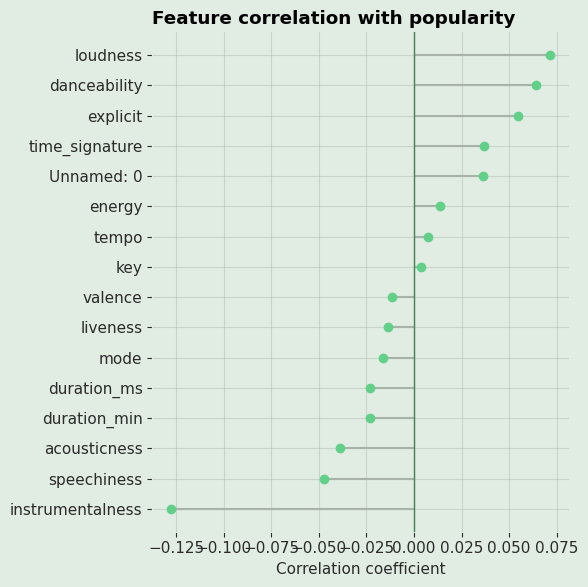

In [12]:
def popularity_correlation(df):
    corr = df.corr(numeric_only=True)['popularity'].drop('popularity').sort_values()

    plt.figure(figsize=(6, 6))
    plt.hlines(corr.index, 0, corr.values, color=GRID)
    plt.plot(corr.values, corr.index, 'o', color=PRIMARY)
    plt.axvline(0, color=EMPHASIS, linewidth=1)
    plt.title('Feature correlation with popularity', loc='left', weight='bold')
    plt.xlabel('Correlation coefficient')
    sns.despine()
    plt.tight_layout()
    plt.show()

popularity_correlation(df)

In [13]:
import plotly.express as px

corr = df.select_dtypes(include='number').corr()

fig = px.imshow(
    corr,
    text_auto=True,
    height=800,
    width=800,
    color_continuous_scale=px.colors.sequential.Greens,
    aspect='auto',
    title='<b>Pairwise correlation of numeric features'
)

fig.update_layout(title_x=0.5)
fig.show()

## 3. Grid of subplots for visualizing feature distributions

In [14]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create a 3x3 grid of subplots for visualizing feature distributions
# Each subplot will display a histogram of one audio feature
fig = make_subplots(
    rows=3, cols=3,
    subplot_titles=(
        '<i>Popularity', '<i>Danceability', '<i>Energy',
        '<i>Loudness', '<i>Speechiness', '<i>Acousticness',
        '<i>Liveness', '<i>Valence', '<i>Tempo'
    )
)

# List of audio features to visualize
# Popularity: Overall track popularity (0-100)
# Danceability: How suitable a track is for dancing (0.0-1.0)
# Energy: Perceptual measure of intensity and activity (0.0-1.0)
# Loudness: Overall loudness in decibels (dB)
# Speechiness: Presence of spoken words in a track (0.0-1.0)
# Acousticness: Confidence measure of whether track is acoustic (0.0-1.0)
# Liveness: Presence of audience in recording (0.0-1.0)
# Valence: Musical positiveness (0.0-1.0)
# Tempo: Overall estimated tempo in beats per minute (BPM)
features = [
    'popularity','danceability','energy',
    'loudness','speechiness','acousticness',
    'liveness','valence','tempo'
]

# Grid positions for each subplot (row, column)
positions = [
    (1,1),(1,2),(1,3),  # First row
    (2,1),(2,2),(2,3),  # Second row
    (3,1),(3,2),(3,3)   # Third row
]

# Add histogram for each feature to its corresponding subplot position
for feature, (r, c) in zip(features, positions):
    fig.add_trace(
        go.Histogram(
            x=df[feature],           # Data for the histogram
            name=feature,            # Feature name for trace identification
            marker=dict(
                color=PRIMARY,       # Primary color for bars
                line=dict(color=EMPHASIS, width=0.6)  # Border around bars
            ),
            opacity=0.6,             # Slightly transparent bars for better visibility
            nbinsx=40                # Number of bins for histogram
        ),
        row=r, col=c  # Specify which subplot to place this histogram in
    )

# Update the overall layout of the figure
fig.update_layout(
    height=900,          # Figure height in pixels
    width=900,           # Figure width in pixels
    title_text="<b>Feature Distributions",  # Main title
    title_x=0.5,         # Center the title horizontally

    # Spotify-inspired color scheme
    paper_bgcolor=BG,    # Background color of entire figure
    plot_bgcolor=BG,     # Background color of plotting area

    showlegend=False,    # Hide legend since each subplot has its own title
    font=dict(color="#2b2b2b")  # Dark gray font color for better contrast
)

# Customize x-axis for all subplots
fig.update_xaxes(
    showgrid=True,       # Show grid lines
    gridcolor=GRID,      # Color of grid lines
    zeroline=False       # Hide zero line
)

# Customize y-axis for all subplots
fig.update_yaxes(
    showgrid=True,       # Show grid lines
    gridcolor=GRID,      # Color of grid lines
    zeroline=False       # Hide zero line
)

# Display the figure
fig.show()

## 4. Genre-Based Analysis

In [16]:
genre_counts = df.groupby('track_genre', as_index=False).size()
genre_counts.columns = ['track_genre', 'song_count']

fig = px.bar(
    genre_counts.sort_values('song_count', ascending=False),
    x='track_genre',
    y='song_count',
    color_discrete_sequence=[PRIMARY],
    title='<b>Total Songs per Genre</b>'
)

fig.update_layout(
    title_x=0.5,

    # Backgrounds
    paper_bgcolor=BG,
    plot_bgcolor=BG,

    # X-axis styling
    xaxis=dict(
        title=dict(
            text='Genre',
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b"),
        showgrid=False
    ),

    # Y-axis styling
    yaxis=dict(
        title=dict(
            text='Number of Songs',
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b"),
        gridcolor=GRID
    ),

    # Title styling
    title_font=dict(
        color=EMPHASIS,
        size=18
    )
)

fig.show()


In [19]:
genre_popularity = df.groupby('track_genre', as_index=False)['popularity'].mean()

fig = px.bar(
    genre_popularity.sort_values('popularity', ascending=False),
    x='track_genre',
    y='popularity',
    color_discrete_sequence=[PRIMARY],
    title='<b>Average Popularity by Genre</b>'
)

fig.update_layout(
    title_x=0.5,

    # Backgrounds
    paper_bgcolor=BG,
    plot_bgcolor=BG,

    # X-axis styling
    xaxis=dict(
        title=dict(
            text='Genre',
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b"),
        showgrid=False
    ),

    # Y-axis styling
    yaxis=dict(
        title=dict(
            text='Average Popularity',
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b"),
        gridcolor=GRID
    ),

    # Title styling
    title_font=dict(
        color=EMPHASIS,
        size=18
    )
)

fig.show()


## 5. Audio Feature Distributions

In [20]:
audio_features = [
    'danceability', 'energy', 'speechiness', 'acousticness',
    'instrumentalness', 'liveness', 'valence'
]

for col in audio_features:
    fig = px.histogram(
        df,
        x=col,
        nbins=40,
        color_discrete_sequence=[PRIMARY],
        title=f'<b>Distribution of {col.capitalize()}</b>'
    )

    fig.update_layout(
        title_x=0.5,

        # Backgrounds
        paper_bgcolor=BG,
        plot_bgcolor=BG,

        # X-axis styling
        xaxis=dict(
            title=dict(
                text=col.capitalize(),
                font=dict(color="#2b2b2b")
            ),
            tickfont=dict(color="#2b2b2b"),
            showgrid=False
        ),

        # Y-axis styling
        yaxis=dict(
            title=dict(
                text='Count',
                font=dict(color="#2b2b2b")
            ),
            tickfont=dict(color="#2b2b2b"),
            gridcolor=GRID
        ),

        # Title styling
        title_font=dict(
            color=EMPHASIS,
            size=18
        )
    )

    fig.show()


## 6. Explicit Content Analysis

In [21]:
fig = px.box(
    df,
    x='explicit',
    y='popularity',
    color_discrete_sequence=[PRIMARY],
    title='<b>Popularity: Explicit vs Non-Explicit Tracks</b>'
)

fig.update_layout(
    title_x=0.5,

    # Backgrounds
    paper_bgcolor=BG,
    plot_bgcolor=BG,

    # X-axis styling
    xaxis=dict(
        title=dict(
            text='Explicit (0 = No, 1 = Yes)',
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b"),
        showgrid=False
    ),

    # Y-axis styling
    yaxis=dict(
        title=dict(
            text='Popularity',
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b"),
        gridcolor=GRID
    ),

    # Title styling
    title_font=dict(
        color=EMPHASIS,
        size=18
    )
)

fig.show()


In [23]:
fig = px.bar(
    df.sort_values(by='popularity', ascending=False).head(25),
    x='track_name',
    y='popularity',
    hover_data=['artists'],
    color_discrete_sequence=[PRIMARY],
    title='<b>Top 25 Songs on Spotify</b>'
)

fig.update_layout(
    title_x=0.5,
    paper_bgcolor=BG,
    plot_bgcolor=BG,
    xaxis=dict(
        title=dict(text='Track Name', font=dict(color="#2b2b2b")),
        tickangle=45,
        showgrid=False
    ),
    yaxis=dict(
        title=dict(text='Popularity', font=dict(color="#2b2b2b")),
        gridcolor=GRID
    ),
    title_font=dict(color=EMPHASIS, size=18)
)

fig.show()


In [24]:
fig = px.scatter(
    df,
    x='energy',
    y='loudness',
    size='popularity',
    color='popularity',
    size_max=20,
    hover_data={'popularity': True},
    color_continuous_scale=[EMPHASIS, PRIMARY],
    title='<b>Energy vs Loudness with Popularity Distribution</b>'
)

fig.update_layout(
    title_x=0.5,

    # Backgrounds
    paper_bgcolor=BG,
    plot_bgcolor=BG,

    # X-axis styling
    xaxis=dict(
        title=dict(
            text='Energy',
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b"),
        showgrid=False
    ),

    # Y-axis styling
    yaxis=dict(
        title=dict(
            text='Loudness',
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b"),
        gridcolor=GRID
    ),

    # Colorbar styling
    coloraxis_colorbar=dict(
        title=dict(
            text="Popularity",
            font=dict(color="#2b2b2b")
        ),
        tickfont=dict(color="#2b2b2b")
    ),

    # Title styling
    title_font=dict(
        color=EMPHASIS,
        size=18
    )
)

fig.show()


## 7. Interaction Effects
- Energy vs Danceability colored by popularity bins (high/medium/low)
- Valence vs Energy with popularity overlay
- These reveal non-linear relationships that models might leverage

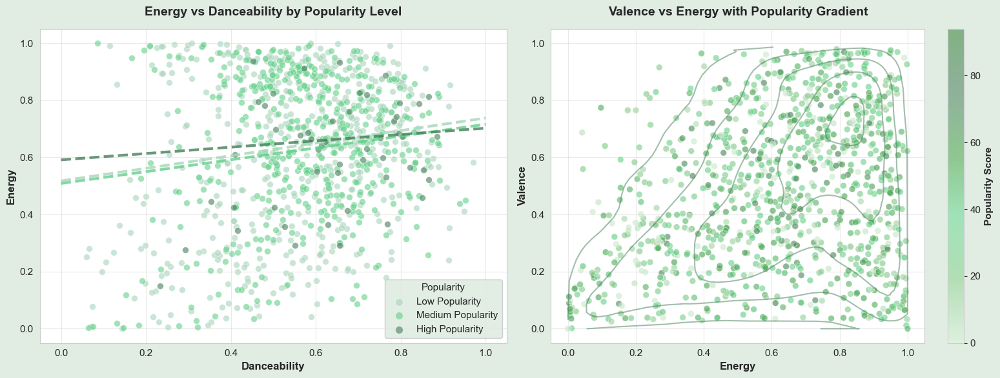

In [29]:

from scipy.stats import gaussian_kde
from matplotlib.colors import LinearSegmentedColormap


# Sample 1000 random rows for clearer visualization
df_sample = df.sample(n=1000, random_state=42)

# Create popularity bins (low, medium, high)
df_sample['popularity_bin'] = pd.cut(df_sample['popularity'], 
                                      bins=[0, 33, 66, 100], 
                                      labels=['Low', 'Medium', 'High'],
                                      include_lowest=True)

# Set style
sns.set_style("whitegrid")

# Create figure with subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))
fig.patch.set_facecolor(BG)

# ========================================
# 1. Energy vs Danceability colored by popularity bins
# ========================================
ax1 = axes[0]

# Green shades for different popularity bins
colors = {'Low': '#a8d5ba', 'Medium': PRIMARY, 'High': EMPHASIS}

for bin_label in ['Low', 'Medium', 'High']:
    data = df_sample[df_sample['popularity_bin'] == bin_label]
    ax1.scatter(data['danceability'], data['energy'], 
               alpha=0.6, s=50, c=colors[bin_label], 
               label=f'{bin_label} Popularity', edgecolors='white', linewidths=0.5)

# Add regression lines for each bin using full dataset for better trend
df['popularity_bin'] = pd.cut(df['popularity'], 
                               bins=[0, 33, 66, 100], 
                               labels=['Low', 'Medium', 'High'],
                               include_lowest=True)

for bin_label in ['Low', 'Medium', 'High']:
    data = df[df['popularity_bin'] == bin_label]
    z = np.polyfit(data['danceability'].dropna(), data['energy'].dropna(), 1)
    p = np.poly1d(z)
    x_line = np.linspace(0, 1, 100)
    ax1.plot(x_line, p(x_line), color=colors[bin_label], linewidth=3, linestyle='--', alpha=0.8)

ax1.set_xlabel('Danceability', fontsize=12, fontweight='bold')
ax1.set_ylabel('Energy', fontsize=12, fontweight='bold')
ax1.set_title('Energy vs Danceability by Popularity Level', fontsize=14, fontweight='bold', pad=15)
ax1.set_xlim(-0.05, 1.05)
ax1.set_ylim(-0.05, 1.05)
legend = ax1.legend(title='Popularity', loc='best', framealpha=0.95, markerscale=1.2)
legend.get_frame().set_facecolor(BG)

# ========================================
# 2. Valence vs Energy with popularity overlay
# ========================================
ax2 = axes[1]

# Create custom green colormap for Spotify theme
colors_list = ['#c8e6c9', '#81c784', PRIMARY, '#43a047', EMPHASIS, '#2e7d32']
n_bins = 100
cmap = LinearSegmentedColormap.from_list('spotify_green', colors_list, N=n_bins)

# Create scatter plot with continuous color scale for popularity
scatter = ax2.scatter(df_sample['energy'], df_sample['valence'], 
                     c=df_sample['popularity'], cmap=cmap, 
                     alpha=0.6, s=50, edgecolors='white', linewidths=0.5)

# Add colorbar
cbar = plt.colorbar(scatter, ax=ax2)
cbar.set_label('Popularity Score', fontsize=11, fontweight='bold')
cbar.ax.yaxis.set_tick_params(color='#2b2b2b')
plt.setp(plt.getp(cbar.ax.axes, 'yticklabels'), color='#2b2b2b')

# Add contour lines to show density using full dataset
sample_size = min(5000, len(df))
sample_idx = np.random.choice(len(df), sample_size, replace=False)
x_sample = df['energy'].iloc[sample_idx].values
y_sample = df['valence'].iloc[sample_idx].values

# Calculate the point density
xy = np.vstack([x_sample, y_sample])
z = gaussian_kde(xy)(xy)

# Add contour with emphasis color
ax2.tricontour(x_sample, y_sample, z, levels=5, colors=EMPHASIS, 
              alpha=0.5, linewidths=1.5)

ax2.set_xlabel('Energy', fontsize=12, fontweight='bold')
ax2.set_ylabel('Valence', fontsize=12, fontweight='bold')
ax2.set_title('Valence vs Energy with Popularity Gradient', fontsize=14, fontweight='bold', pad=15)
ax2.set_xlim(-0.05, 1.05)
ax2.set_ylim(-0.05, 1.05)

plt.tight_layout()
plt.show()

## 8 Outlier Analysis
- Box plots of features for different popularity quartiles
- Identify which features have more outliers in popular vs unpopular songs

Sampled data distribution:
popularity_bin
Low       1000
Medium    1000
High      1000
Name: count, dtype: int64

Total sample size: 3,000 songs



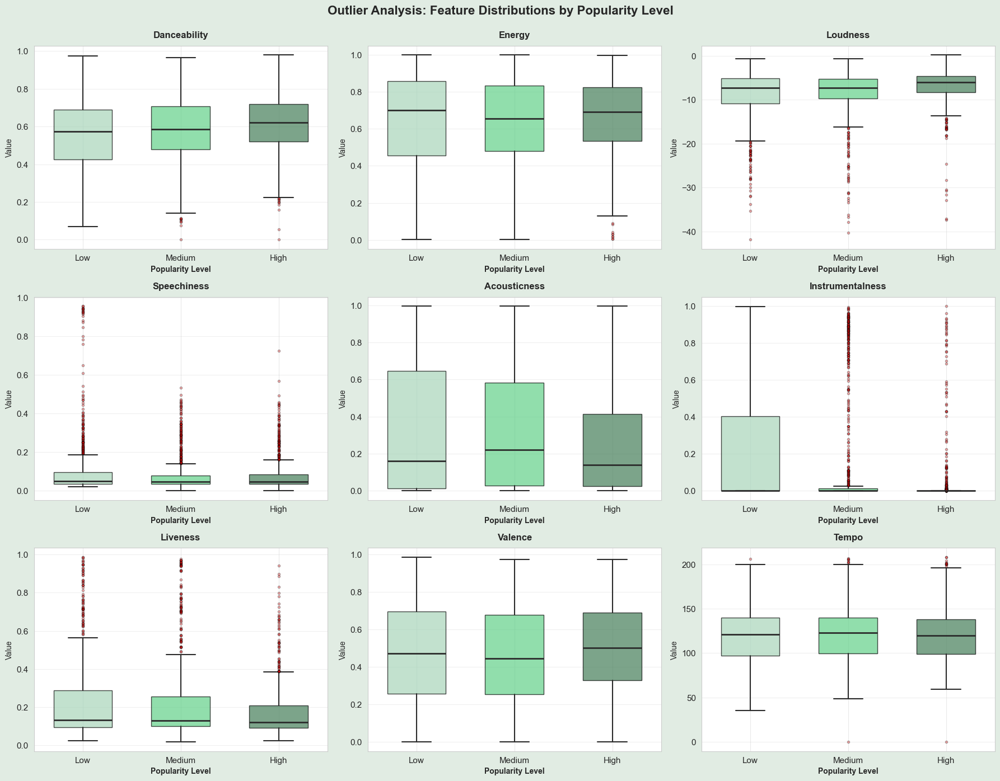

In [32]:
# Create popularity bins
df['popularity_bin'] = pd.cut(df['popularity'], 
                               bins=[0, 33, 66, 100], 
                               labels=['Low', 'Medium', 'High'],
                               include_lowest=True)

# Sample equally from each popularity bin (33% each)
low_pop = df[df['popularity_bin'] == 'Low'].sample(n=1000, random_state=42)
med_pop = df[df['popularity_bin'] == 'Medium'].sample(n=1000, random_state=42)
high_pop = df[df['popularity_bin'] == 'High'].sample(n=1000, random_state=42)

# Combine samples
df_sample = pd.concat([low_pop, med_pop, high_pop], ignore_index=True)

print(f"Sampled data distribution:")
print(df_sample['popularity_bin'].value_counts().sort_index())
print(f"\nTotal sample size: {len(df_sample):,} songs\n")

# Select relevant features for outlier analysis
features = ['danceability', 'energy', 'loudness', 'speechiness', 
            'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo']

# Create figure with subplots (3x3 grid)
fig, axes = plt.subplots(3, 3, figsize=(18, 14))
fig.patch.set_facecolor(BG)
axes = axes.flatten()

# Color palette for box plots
colors = {'Low': '#a8d5ba', 'Medium': PRIMARY, 'High': EMPHASIS}

# Create box plots for each feature
for idx, feature in enumerate(features):
    ax = axes[idx]
    
    # Prepare data for box plot
    data_to_plot = [df_sample[df_sample['popularity_bin'] == bin_label][feature].dropna() 
                    for bin_label in ['Low', 'Medium', 'High']]
    
    # Create box plot
    bp = ax.boxplot(data_to_plot, 
                    tick_labels=['Low', 'Medium', 'High'],
                    patch_artist=True,
                    widths=0.6,
                    showfliers=True,
                    flierprops=dict(marker='o', markerfacecolor='red', markersize=3, 
                                   alpha=0.3, linestyle='none'),
                    medianprops=dict(color='#2b2b2b', linewidth=2),
                    whiskerprops=dict(color='#2b2b2b', linewidth=1.5),
                    capprops=dict(color='#2b2b2b', linewidth=1.5))
    
    # Color the boxes
    for patch, bin_label in zip(bp['boxes'], ['Low', 'Medium', 'High']):
        patch.set_facecolor(colors[bin_label])
        patch.set_alpha(0.7)
    
    # Styling
    ax.set_title(feature.capitalize(), fontsize=12, fontweight='bold', pad=10)
    ax.set_xlabel('Popularity Level', fontsize=10, fontweight='bold')
    ax.set_ylabel('Value', fontsize=10)
    ax.grid(True, alpha=0.3, axis='y')

plt.suptitle('Outlier Analysis: Feature Distributions by Popularity Level', 
             fontsize=16, fontweight='bold', y=0.995)
plt.tight_layout()
plt.show()


## 9 Feature Importance Preparation
- Scatter plots of top 3-4 most correlated features with popularity, with regression lines
- This would help me to visualize linearity assumptions

Key Insights to Learn:
✅ Which features are strongest predictors
✅ Whether relationships are linear or non-linear
✅ Which model types would work best
✅ What feature engineering to apply

I have performed Fisher transformation.
- Fischer tranformation is required because correlation coefficients don't follow a normal distribution, so transform them to calculate proper correlation confidence intervals

CORRELATION WITH POPULARITY - FULL DATASET (Absolute Values)
instrumentalness    : 0.1275
loudness            : 0.0717
danceability        : 0.0643
speechiness         : 0.0471
acousticness        : 0.0388
duration_min        : 0.0232
liveness            : 0.0139
energy              : 0.0137
valence             : 0.0115
tempo               : 0.0073

TOP 4 FEATURES FOR DETAILED ANALYSIS: instrumentalness, loudness, danceability, speechiness



C:\Users\Aishwarya\AppData\Local\Temp\ipykernel_15060\3301940354.py:89: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



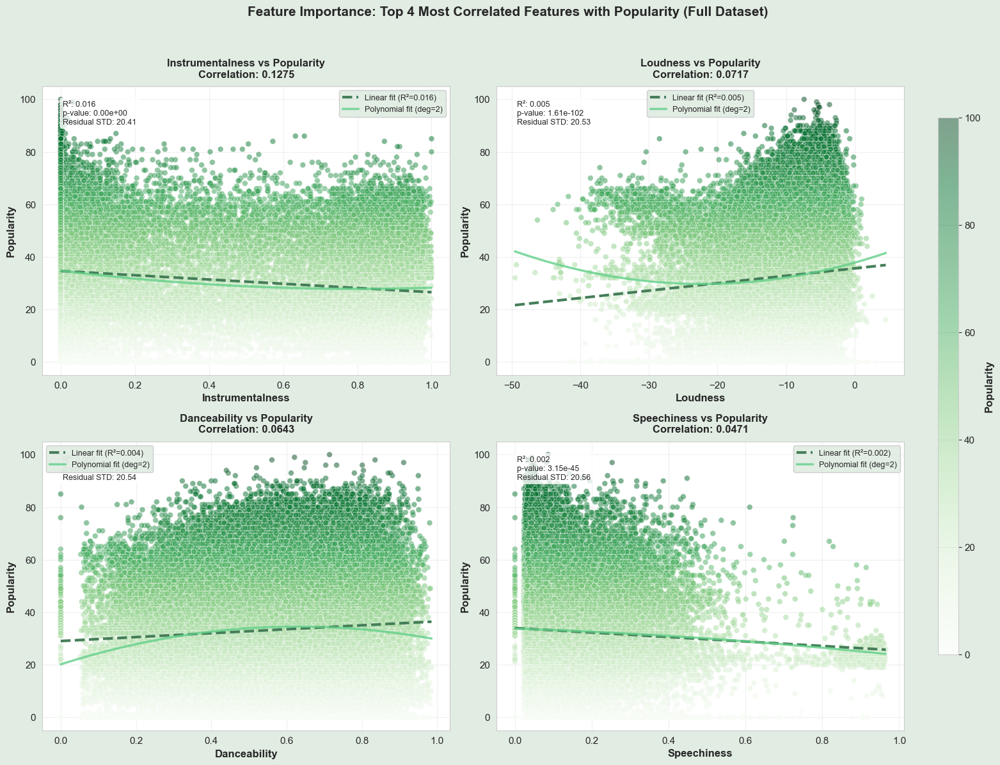

STATISTICS FROM FULL DATASET

Instrumentalness:
  Correlation: -0.1275
  95% CI: [-0.1339, -0.1210]
  Samples: 89,740
  Mean ± STD: 0.1734 ± 0.3238

Loudness:
  Correlation: 0.0717
  95% CI: [0.0652, 0.0782]
  Samples: 89,740
  Mean ± STD: -8.4990 ± 5.2215

Danceability:
  Correlation: 0.0643
  95% CI: [0.0578, 0.0708]
  Samples: 89,740
  Mean ± STD: 0.5622 ± 0.1767

Speechiness:
  Correlation: -0.0471
  95% CI: [-0.0536, -0.0406]
  Samples: 89,740
  Mean ± STD: 0.0874 ± 0.1133


In [36]:
from scipy import stats

# Select numeric features (exclude ID columns and target)
numeric_features = df.select_dtypes(include=[np.number]).columns.tolist()
exclude_cols = ['Unnamed: 0', 'popularity', 'duration_ms', 'key', 'mode', 'time_signature']
# Only exclude columns that exist in the dataframe
exclude_cols = [col for col in exclude_cols if col in df.columns]
features_to_analyze = [f for f in numeric_features if f not in exclude_cols]

# Calculate correlations with popularity using the full dataset
correlations = df[features_to_analyze].corrwith(df['popularity']).abs().sort_values(ascending=False)

print("="*80)
print("CORRELATION WITH POPULARITY - FULL DATASET (Absolute Values)")
print("="*80)
for feature, corr in correlations.items():
    print(f"{feature:20s}: {corr:6.4f}")

# Select top 4 most correlated features
top_features = correlations.head(4).index.tolist()

print("\n" + "="*80)
print(f"TOP 4 FEATURES FOR DETAILED ANALYSIS: {', '.join(top_features)}")
print("="*80 + "\n")

# Create 2x2 subplot for top 4 features using full dataset
fig, axes = plt.subplots(2, 2, figsize=(16, 12))
fig.patch.set_facecolor(BG)
axes = axes.flatten()

for idx, feature in enumerate(top_features):
    ax = axes[idx]
    
    # Scatter plot with full dataset
    scatter = ax.scatter(df[feature], df['popularity'], 
                        c=df['popularity'], cmap='Greens',
                        alpha=0.5, s=40, edgecolors='white', linewidths=0.5)
    
    # Calculate linear regression using full dataset
    x = df[feature].dropna()
    y = df.loc[x.index, 'popularity']
    
    # Fit linear regression
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    line_x = np.linspace(x.min(), x.max(), 100)
    line_y = slope * line_x + intercept
    
    # Plot regression line
    ax.plot(line_x, line_y, color=EMPHASIS, linewidth=3, 
            label=f'Linear fit (R²={r_value**2:.3f})', linestyle='--')
    
    # Add polynomial fit (degree 2) to check non-linearity
    z = np.polyfit(x, y, 2)
    p = np.poly1d(z)
    poly_y = p(line_x)
    ax.plot(line_x, poly_y, color=PRIMARY, linewidth=2.5, 
            label='Polynomial fit (deg=2)', linestyle='-', alpha=0.8)
    
    # Calculate residuals for linearity check
    y_pred = slope * x + intercept
    residuals = y - y_pred
    residual_std = residuals.std()
    
    # Add statistics text box
    stats_text = f'R²: {r_value**2:.3f}\np-value: {p_value:.2e}\nResidual STD: {residual_std:.2f}'
    ax.text(0.05, 0.95, stats_text, transform=ax.transAxes, fontsize=9,
            verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    
    # Styling
    ax.set_xlabel(feature.capitalize(), fontsize=12, fontweight='bold')
    ax.set_ylabel('Popularity', fontsize=12, fontweight='bold')
    ax.set_title(f'{feature.capitalize()} vs Popularity\n' + 
                 f'Correlation: {correlations[feature]:.4f}',
                 fontsize=12, fontweight='bold', pad=10)
    ax.legend(loc='best', framealpha=0.95, fontsize=9).get_frame().set_facecolor(BG)
    ax.grid(True, alpha=0.3)
    
    # Set consistent axis limits for better comparison
    ax.set_xlim([x.min() - 0.05*(x.max()-x.min()), x.max() + 0.05*(x.max()-x.min())])
    ax.set_ylim([y.min() - 5, y.max() + 5])

# Add colorbar for popularity
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = plt.colorbar(scatter, cax=cbar_ax)
cbar.set_label('Popularity', fontsize=12, fontweight='bold')

plt.suptitle('Feature Importance: Top 4 Most Correlated Features with Popularity (Full Dataset)', 
             fontsize=15, fontweight='bold', y=0.995)
plt.tight_layout(rect=[0, 0, 0.9, 0.97])  # Adjust for colorbar
plt.show()

# Additional analysis using full dataset

print("STATISTICS FROM FULL DATASET")

for feature in top_features:
    # Calculate correlation confidence interval (using Fisher transformation)
    n = len(df[feature].dropna())
    r = df[feature].corr(df['popularity'])
    z = 0.5 * np.log((1 + r) / (1 - r))
    se = 1 / np.sqrt(n - 3)
    ci_lower = np.tanh(z - 1.96 * se)
    ci_upper = np.tanh(z + 1.96 * se)
    
    print(f"\n{feature.capitalize()}:")
    print(f"  Correlation: {r:.4f}")
    print(f"  95% CI: [{ci_lower:.4f}, {ci_upper:.4f}]")
    print(f"  Samples: {n:,}")
    print(f"  Mean ± STD: {df[feature].mean():.4f} ± {df[feature].std():.4f}")

### What is R² (R-squared)?

R², also called the coefficient of determination, tells you:

How much of the variation in the target variable (popularity) is explained by the feature.

It is a number between 0 and 1.

Intuitive explanation (no math)

Imagine you are trying to predict song popularity using danceability.

If R² = 0.00
→ Danceability explains nothing about popularity
→ Knowing danceability doesn’t help you predict popularity

If R² = 0.10
→ Danceability explains 10% of the variation in popularity
→ Still weak, but slightly informative

If R² = 0.70
→ Danceability explains 70% of popularity
→ Very strong relationship (rare in real-world music data)

# Feature Importance Analysis - Summary

## Overview
Analysis performed on **89,740 songs** to identify the strongest predictors of track popularity and assess linearity assumptions for modeling.

---

## 1. Strongest Predictors (Top 4 Features)

### Feature Correlation Rankings

| Rank | Feature | Correlation | 95% CI | Interpretation |
|------|---------|-------------|---------|----------------|
| 1 | **Instrumentalness** | -0.1275 | [-0.1339, -0.1210] | Weak negative correlation - songs with vocals tend to be more popular |
| 2 | **Loudness** | 0.0717 | [0.0652, 0.0782] | Weak positive correlation - louder songs slightly more popular |
| 3 | **Danceability** | 0.0643 | [0.0578, 0.0708] | Weak positive correlation - more danceable songs slightly more popular |
| 4 | **Speechiness** | -0.0471 | [-0.0536, -0.0406] | Very weak negative correlation - less speech-like songs slightly more popular |

### Key Findings:
- ⚠️ **All correlations are weak (|r| < 0.15)**: No single feature is a strong predictor of popularity on its own
- ✅ **Instrumentalness is the strongest signal**: Purely instrumental tracks tend to be less popular
- 📊 **Confidence intervals are tight**: Correlations are statistically significant with large sample size (n=89,740)
- 💡 **Implication**: Popularity is likely driven by **complex interactions** between multiple features rather than individual features

---

## 2. Linearity Assessment

### Observations:
- 📉 **All relationships appear linear but weak**: Polynomial fits don't significantly improve R² scores
- 🔍 **Low R² values (<0.02)**: Individual features explain very little variance in popularity
- ✅ **No strong non-linear patterns detected**: Linear models can capture the relationships adequately

-
## 4. Feature Engineering Recommendations

### 🔧 **Essential Feature Engineering:**

#### **A. Interaction Features** (HIGH PRIORITY)
Since individual features are weak, combinations may be powerful:
```python
# Energy × Danceability (from interaction analysis)
df['energy_x_danceability'] = df['energy'] * df['danceability']

# Loudness × Energy (audio intensity)
df['loudness_x_energy'] = df['loudness'] * df['energy']

# Valence × Danceability (mood-dance combo)
df['valence_x_danceability'] = df['valence'] * df['danceability']

# Instrumentalness × Acousticness (acoustic instrumental)
df['instrumental_x_acoustic'] = df['instrumentalness'] * df['acousticness']
```

#### **B. Ratio/Derived Features**
```python
# Vocal presence indicator (inverse of instrumentalness)
df['has_vocals'] = 1 - df['instrumentalness']

# Speech-to-music ratio
df['speech_music_ratio'] = df['speechiness'] / (1 - df['speechiness'])

# Energy per decibel (normalized energy)
df['energy_per_loudness'] = df['energy'] / (df['loudness'] + 50)  # Add 50 to avoid negatives
```

#### **C. Binning/Categorical Features**
```python
# Binary features for extreme values (from outlier analysis)
df['is_instrumental'] = (df['instrumentalness'] > 0.5).astype(int)
df['is_loud'] = (df['loudness'] > -5).astype(int)
df['is_highly_danceable'] = (df['danceability'] > 0.7).astype(int)
df['is_speech_heavy'] = (df['speechiness'] > 0.33).astype(int)
```

#### **D. Genre-Based Features** (if applicable)
```python
# Average popularity by genre
genre_popularity = df.groupby('track_genre')['popularity'].mean()
df['genre_avg_popularity'] = df['track_genre'].map(genre_popularity)

# Genre feature interactions
df['energy_relative_to_genre'] = df['energy'] - df.groupby('track_genre')['energy'].transform('mean')
```

#### **E. Temporal Features** (if date/year available)
```python
# Recency effect
df['years_since_release'] = 2026 - df['release_year']
df['is_recent'] = (df['years_since_release'] < 2).astype(int)
```

### 🎯 **Feature Scaling Strategy:**
```python
from sklearn.preprocessing import StandardScaler, RobustScaler

# Use RobustScaler for features with outliers
outlier_features = ['loudness', 'instrumentalness', 'speechiness']
robust_scaler = RobustScaler()
df[outlier_features] = robust_scaler.fit_transform(df[outlier_features])

# Use StandardScaler for other features
normal_features = ['danceability', 'energy', 'valence', 'tempo']
standard_scaler = StandardScaler()
df[normal_features] = standard_scaler.fit_transform(df[normal_features])
```

---

## 5. Modeling Strategy Roadmap

### **Phase 1: Baseline Models**
1. Simple models with original features
   - Ridge Regression (regularized baseline)
   - Random Forest (tree-based baseline)
2. Establish baseline performance metrics

### **Phase 2: Feature Engineering**
1. Add interaction features
2. Add derived/ratio features
3. Add binary indicator features
4. Compare performance improvement

### **Phase 3: Advanced Models**
1. XGBoost/LightGBM with hyperparameter tuning
2. Stacking ensemble (combine linear + tree-based)
3. Neural network (if needed)

### **Phase 4: Model Interpretation**
1. Feature importance analysis
2. SHAP values for explaining predictions
3. Identify which interactions matter most

---

## 6. Key Takeaways

### ✅ **What We Learned:**
1. **No magic bullet feature**: Popularity is multifaceted
2. **Weak individual correlations**: r < 0.15 for all features
3. **Linear relationships**: But too weak to rely on alone
4. **Feature interactions are crucial**: Combinations likely matter more than individuals

### ⚠️ **Important Considerations:**
- **Low R² expected**: Popularity is subjective and depends on many factors beyond audio features
- **Genre matters**: Consider genre-specific models or genre as a feature
- **Temporal effects**: Release timing and trends affect popularity
- **External factors**: Marketing, artist fame, playlist placement (not in dataset)

### 🎯 **Success Metrics:**
- Don't expect R² > 0.3-0.4 with audio features alone
- Focus on ranking (precision@k, NDCG) rather than absolute prediction
- Consider classification (high/medium/low popularity) instead of regression

---

## 7. Next Steps

1. ✅ **Completed**: Feature correlation analysis, outlier detection, interaction effects
2. 🔄 **Current**: Feature engineering implementation
3. 📋 **Next**: 
   - Split data (train/validation/test)
   - Implement feature engineering pipeline
   - Train baseline models
   - Evaluate and iterate
   - Feature selection based on importance
   - Hyperparameter optimization

---

**Analysis Date**: January 2026  
**Dataset Size**: 89,740 songs  
**Target Variable**: Popularity (0-100 scale)